In [50]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
import plotly.express as px
import re

### Importing the training dataset

In [2]:
df_train=pd.read_csv('unclean_training_data_v2.csv')

In [3]:
import random
def rand_pop(num:int):
    num = str(num)
    tens_once = random.randint(100, 200)
    num = num[:-3]+str(tens_once)
    return int(num)

In [4]:
df_train['population_density'] = df_train['population_density'].apply(rand_pop)

In [5]:
import re
def rand_policyholder(num:int):
    tens_once = str(random.randint(0, 9))
    text = re.sub(r'\d[.]', tens_once+'.',str(num)) 
    return float(num)

In [6]:
df_train['age_of_policyholder'].apply(rand_policyholder)

0        49.000000
1        25.540541
2        26.378378
3        30.567568
4        48.162162
           ...    
58590    49.000000
58591    38.108108
58592    32.243243
58593    41.459459
58594    31.405405
Name: age_of_policyholder, Length: 58595, dtype: float64

In [7]:
df_train['age_of_policyholder'].unique()

array([49.        , 25.54054054, 26.37837838, 30.56756757, 48.16216216,
       38.10810811, 28.05405405, 29.72972973, 18.83783784, 31.40540541,
       44.81081081, 34.75675676, 19.67567568, 43.13513514, 45.64864865,
       33.91891892, 36.43243243, 27.21621622, 46.48648649, 20.51351351,
       21.35135135, 35.59459459, 33.08108108, 73.2972973 , 53.18918919,
       32.24324324, 28.89189189, 52.35135135, 24.7027027 , 23.86486486,
       37.27027027, 39.78378378, 51.51351351, 23.02702703, 40.62162162,
       18.        , 41.45945946, 59.05405405, 22.18918919, 57.37837838,
       50.67567568, 47.32432432, 38.94594595, 43.97297297, 49.83783784,
       56.54054054, 42.2972973 , 54.02702703, 63.24324324, 62.40540541,
       66.59459459, 54.86486486, 60.72972973, 59.89189189, 58.21621622,
       55.7027027 , 64.91891892, 61.56756757, 64.08108108, 68.27027027,
       74.13513514, 69.94594595, 65.75675676, 67.43243243, 70.78378378,
       77.48648649, 75.81081081, 69.10810811, 72.45945946, 74.97

In [8]:
df_train.head(5)

,policy_id,policy_tenure,age_of_car,age_of_policyholder,area_cluster,population_density,make,segment,model,fuel_type,...,is_brake_assist,is_power_door_locks,is_central_locking,is_power_steering,is_driver_seat_height_adjustable,is_day_night_rear_view_mirror,is_ecw,is_speed_alert,ncap_rating,is_claim
0,ID00001,0.515874,0.75,49.000000,C1,4158,1,A,M1,CNG,...,No,No,No,Yes,No,No,No,Yes,0,0
1,ID00002,0.672619,0.30,25.540541,C2,27129,1,A,M1,CNG,...,No,No,No,Yes,No,No,No,Yes,0,0
2,ID00003,0.841110,0.30,26.378378,C3,4188,1,A,M1,CNG,...,No,No,No,Yes,No,No,No,Yes,0,0
3,ID00004,0.900277,1.65,30.567568,C4,21179,1,C1,M2,Petrol,...,Yes,Yes,Yes,Yes,Yes,Yes,Yes,Yes,2,0
4,ID00005,0.596403,1.65,48.162162,C5,34170,2,A,M3,Petrol,...,No,Yes,Yes,Yes,No,Yes,Yes,Yes,2,0


In [9]:
df_train['policy_tenure'].unique()

array([0.51587359, 0.67261851, 0.84111026, ..., 1.16227251, 1.2363069 ,
       0.12442893])

In [10]:
df_train.columns

Index(['policy_id', 'policy_tenure', 'age_of_car', 'age_of_policyholder',
       'area_cluster', 'population_density', 'make', 'segment', 'model',
       'fuel_type', 'max_torque', 'max_power', 'engine_type', 'airbags',
       'is_esc', 'is_adjustable_steering', 'is_tpms', 'is_parking_sensors',
       'is_parking_camera', 'rear_brakes_type', 'displacement', 'cylinder',
       'transmission_type', 'gear_box', 'steering_type', 'turning_radius',
       'length', 'width', 'height', 'gross_weight', 'is_front_fog_lights',
       'is_rear_window_wiper', 'is_rear_window_washer',
       'is_rear_window_defogger', 'is_brake_assist', 'is_power_door_locks',
       'is_central_locking', 'is_power_steering',
       'is_driver_seat_height_adjustable', 'is_day_night_rear_view_mirror',
       'is_ecw', 'is_speed_alert', 'ncap_rating', 'is_claim'],
      dtype='object')

In [11]:
df_temp = df_train[['max_torque']]
df_temp

,max_torque
0,60Nm@3500rpm
1,60Nm@3500rpm
2,60Nm@3500rpm
3,113Nm@4400rpm
4,91Nm@4250rpm
...,...
58590,91Nm@4250rpm
58591,60Nm@3500rpm
58592,60Nm@3500rpm
58593,113Nm@4400rpm


In [12]:
def count_torque_format(max_torque):
    text = re.findall(r'[0-9]{0,5}Nm@[0-9]{0,4}rpm', str(max_torque))
    return False if len(text) == 0 else True

In [13]:
df_temp['check_format'] = df_temp['max_torque'].apply(count_torque_format)
df_temp

/var/folders/4k/d3s8s5bx2tq_fnbpgv52ztfm0000gn/T/ipykernel_97111/3307240530.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_temp['check_format'] = df_temp['max_torque'].apply(count_torque_format)


,max_torque,check_format
0,60Nm@3500rpm,True
1,60Nm@3500rpm,True
2,60Nm@3500rpm,True
3,113Nm@4400rpm,True
4,91Nm@4250rpm,True
...,...,...
58590,91Nm@4250rpm,True
58591,60Nm@3500rpm,True
58592,60Nm@3500rpm,True
58593,113Nm@4400rpm,True


In [14]:
df_temp['check_format'].unique()

array([ True])

In [15]:
def max_torque_nm_rpm(text:str):
    nm = re.sub(r'Nm@[0-9]{0,4}rpm','', text)
    rpm = re.sub(r'\d{0,5}(.\d{0,5})?Nm@','', text)
    return float(nm), int(rpm[:-3])

In [16]:
df_temp = df_train['max_torque'].apply(lambda x: max_torque_nm_rpm(x))
df_train['max_torque_nm'] = df_temp.apply(lambda x: x[0])
df_train['max_torque_rpm'] = df_temp.apply(lambda x: x[1])

In [17]:
def max_power_bhp_rpm(text:str):
    bhp = re.sub(r'bhp@[0-9]{0,4}rpm','', text)
    rpm = re.sub(r'\d{0,5}(.\d{0,5})?bhp@','', text)
    return float(bhp), int(rpm[:-3])

In [18]:
df_temp = df_train['max_power'].apply(lambda x: max_power_bhp_rpm(x))
df_train['max_power_bhp'] = df_temp.apply(lambda x: x[0])
df_train['max_power_rpm'] = df_temp.apply(lambda x: x[1])
df_train

,policy_id,policy_tenure,age_of_car,age_of_policyholder,area_cluster,population_density,make,segment,model,fuel_type,...,is_driver_seat_height_adjustable,is_day_night_rear_view_mirror,is_ecw,is_speed_alert,ncap_rating,is_claim,max_torque_nm,max_torque_rpm,max_power_bhp,max_power_rpm
0,ID00001,0.515874,0.75,49.000000,C1,4158,1,A,M1,CNG,...,No,No,No,Yes,0,0,60.0,3500,40.36,6000
1,ID00002,0.672619,0.30,25.540541,C2,27129,1,A,M1,CNG,...,No,No,No,Yes,0,0,60.0,3500,40.36,6000
2,ID00003,0.841110,0.30,26.378378,C3,4188,1,A,M1,CNG,...,No,No,No,Yes,0,0,60.0,3500,40.36,6000
3,ID00004,0.900277,1.65,30.567568,C4,21179,1,C1,M2,Petrol,...,Yes,Yes,Yes,Yes,2,0,113.0,4400,88.50,6000
4,ID00005,0.596403,1.65,48.162162,C5,34170,2,A,M3,Petrol,...,No,Yes,Yes,Yes,2,0,91.0,4250,67.06,5500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58590,ID58588,0.355089,1.95,49.000000,C8,8118,2,A,M3,Petrol,...,No,Yes,Yes,Yes,2,0,91.0,4250,67.06,5500
58591,ID58589,1.199642,0.30,38.108108,C14,7141,1,A,M1,CNG,...,No,No,No,Yes,0,0,60.0,3500,40.36,6000
58592,ID58590,1.162273,0.75,32.243243,C5,34169,1,A,M1,CNG,...,No,No,No,Yes,0,0,60.0,3500,40.36,6000
58593,ID58591,1.236307,2.10,41.459459,C8,8166,1,B2,M6,Petrol,...,Yes,Yes,Yes,Yes,2,0,113.0,4400,88.50,6000


### Duplicate Check and Removal

In [19]:
# Checking for duplicate values

print ('Number of duplicated vales: {}'.format(df_train.duplicated().sum()))

Number of duplicated vales: 0


In [20]:
df_train=df_train.drop_duplicates()

In [21]:
# Checking for duplicate values

print ('Number of duplicated vales: {}'.format(df_train.duplicated().sum()))

Number of duplicated vales: 0


### Since the entire dataset is for training and we have a train set separately, all the pre-processing steps will be applied here

### Missing Value Checks

In [22]:
df_train.isnull().sum()

policy_id                              0
policy_tenure                          0
age_of_car                             0
age_of_policyholder                    0
area_cluster                           0
population_density                     0
make                                   0
segment                                0
model                                  0
fuel_type                              0
max_torque                             0
max_power                              0
engine_type                            0
airbags                                0
is_esc                                 0
is_adjustable_steering                 0
is_tpms                                0
is_parking_sensors                     0
is_parking_camera                      0
rear_brakes_type                       0
displacement                        2996
cylinder                               0
transmission_type                      0
gear_box                               0
steering_type   

In [23]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 58595 entries, 0 to 58594
Data columns (total 48 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   policy_id                         58595 non-null  object 
 1   policy_tenure                     58595 non-null  float64
 2   age_of_car                        58595 non-null  float64
 3   age_of_policyholder               58595 non-null  float64
 4   area_cluster                      58595 non-null  object 
 5   population_density                58595 non-null  int64  
 6   make                              58595 non-null  int64  
 7   segment                           58595 non-null  object 
 8   model                             58595 non-null  object 
 9   fuel_type                         58595 non-null  object 
 10  max_torque                        58595 non-null  object 
 11  max_power                         58595 non-null  object 
 12  engi

### Converting yes to 1 and no to 0 for ease in imputations and further analysis

In [24]:
df_train = df_train.replace({'Yes': 1, 'No': 0})

### Using mode to impute missing values in is_power_steering column since most cars do have power steering

In [25]:
df_train['is_power_steering'].fillna(df_train["is_power_steering"].mode()[0], inplace=True)

In [26]:
df_train['is_power_steering'].value_counts()

1.0    57402
0.0     1193
Name: is_power_steering, dtype: int64

### Using KNN Imputer to impute missing values for displacement, gross_weight and turning_radius

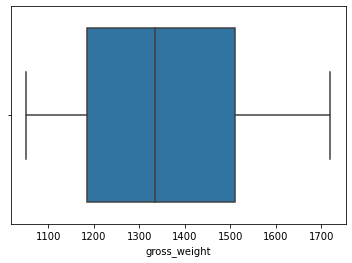

In [27]:
# Boxplot to see how skewed the datapoints are to decide if imputation should be done by mean, median or 
# some other method

sns.boxplot(x='gross_weight', data=df_train)
plt.show()

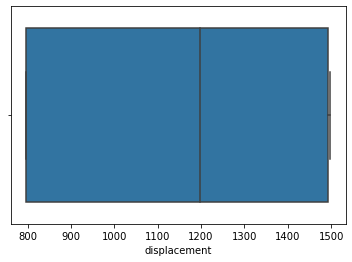

In [28]:
# Boxplot to see how skewed the datapoints are to decide if imputation should be done by mean or median for numericals

sns.boxplot(x='displacement', data=df_train)
plt.show()

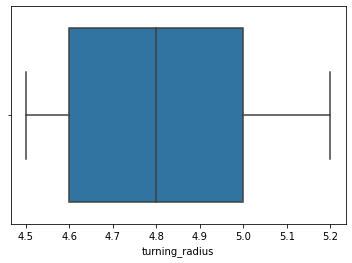

In [29]:
# Boxplot to see how skewed the datapoints are to decide if imputation should be done by mean or median for numericals

sns.boxplot(x='turning_radius', data=df_train)
plt.show()

In [30]:
from sklearn.impute import KNNImputer

def impute_numeric_knn(df, col_name, n_neighbors):

    # create a copy of the input dataframe
    df_imputed = df.copy()
    
    # create a KNNImputer object with the specified number of neighbors
    imputer = KNNImputer(n_neighbors=n_neighbors)
    
    # select the column to impute and reshape it to a 2D array
    col_values = df_imputed[col_name].values.reshape(-1, 1)
    
    # impute the missing values in the column
    col_imputed = imputer.fit_transform(col_values)
    
    # replace the missing values in the original column with the imputed values
    df_imputed.loc[:, col_name] = col_imputed.flatten()
    
    return df_imputed


In [31]:
df_train_cleaned = impute_numeric_knn(df_train, 'displacement', 2)
df_train_cleaned = impute_numeric_knn(df_train_cleaned, 'turning_radius', 2)
df_train_cleaned = impute_numeric_knn(df_train_cleaned, 'gross_weight', 2)

In [32]:
df_train_cleaned.isnull().sum()

policy_id                           0
policy_tenure                       0
age_of_car                          0
age_of_policyholder                 0
area_cluster                        0
population_density                  0
make                                0
segment                             0
model                               0
fuel_type                           0
max_torque                          0
max_power                           0
engine_type                         0
airbags                             0
is_esc                              0
is_adjustable_steering              0
is_tpms                             0
is_parking_sensors                  0
is_parking_camera                   0
rear_brakes_type                    0
displacement                        0
cylinder                            0
transmission_type                   0
gear_box                            0
steering_type                       0
turning_radius                      0
length      

### EDA with Visualization

In [33]:
print(df_train_cleaned[df_train_cleaned['is_claim']==1].shape)
print(df_train_cleaned[df_train_cleaned['is_claim']==0].shape)

(3748, 48)
(54847, 48)


<AxesSubplot:>

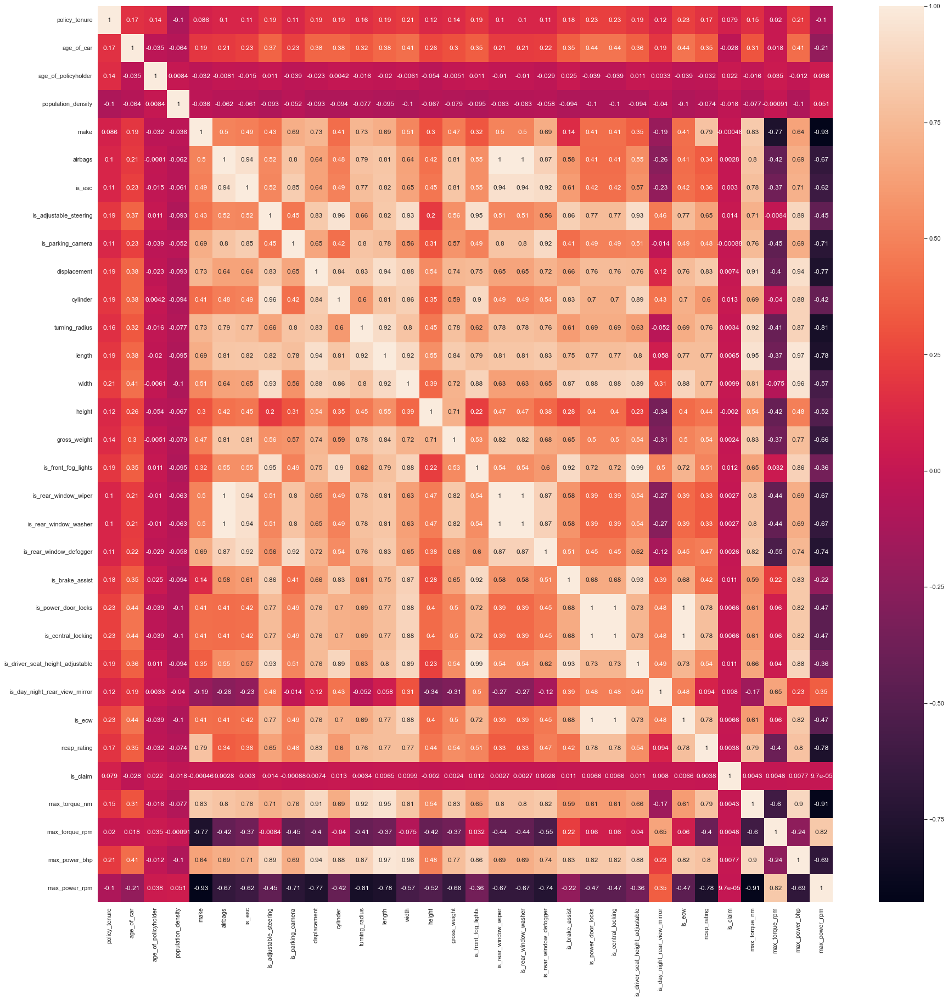

In [34]:
# Heatmap with correlation between features.
df_numerical = df_train_cleaned.select_dtypes(exclude=object)
df_numerical.drop(columns=['is_tpms',
                           'gear_box', 
                           'is_parking_sensors', 
                           'is_power_steering', 
                           'is_speed_alert'], axis=1, inplace=True)

sns.set(rc={'figure.figsize':(30,30)})
sns.heatmap(df_numerical.corr(), annot=True, )

## Age of Car vs Policy Tenure

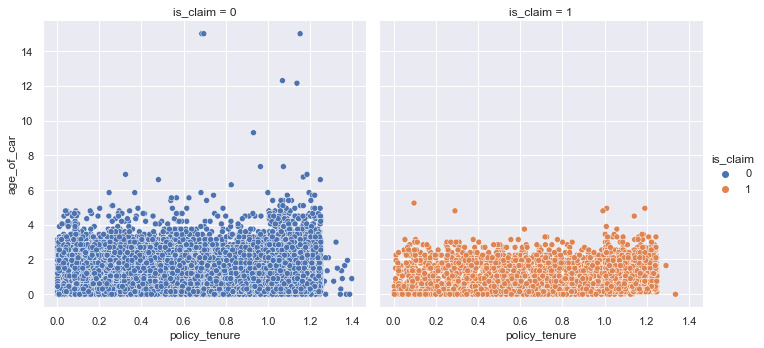

In [35]:
# Scatter Plot
sns.set(rc={'figure.figsize':(20,10)})
sns.relplot(x='policy_tenure', 
            y='age_of_car',
            col='is_claim',
            data=df_train_cleaned, hue='is_claim')

# Age of Policyholder VS Policy Tenure

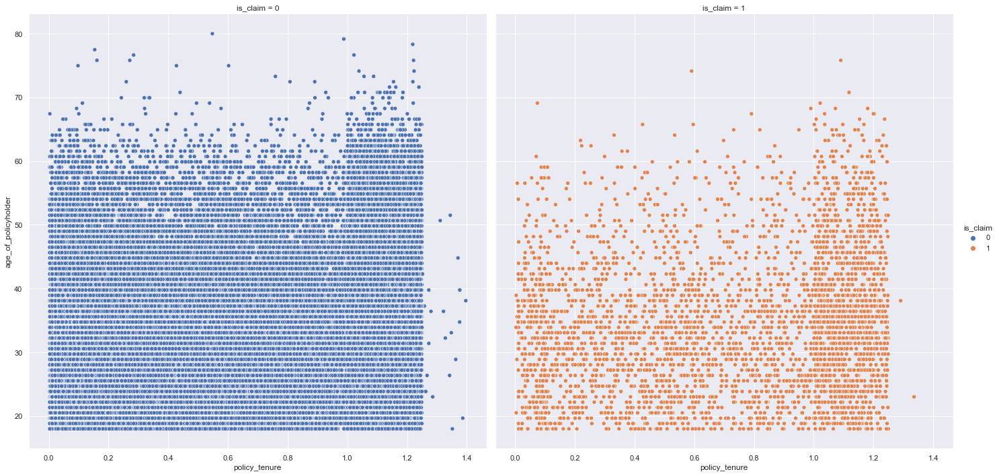

In [36]:
# Scatter Plot
sns.relplot(x='policy_tenure', 
            y='age_of_policyholder',
            col='is_claim',
            data=df_train_cleaned,hue='is_claim', height=10)

# Max Torque VS Max Power

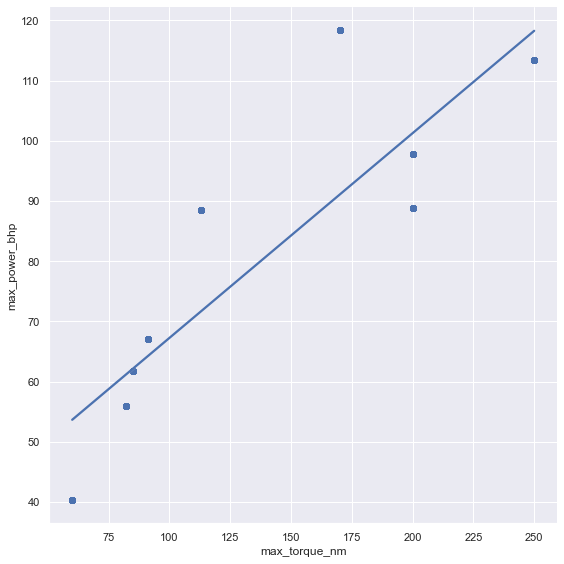

In [38]:
# Scatter Plot
sns.lmplot(x='max_torque_nm', 
            y='max_power_bhp',
#             col='is_claim',
            data=df_train_cleaned,
#            hue='is_claim', 
           height=8)

# Distribution for Age of policyholder

<AxesSubplot:xlabel='age_of_policyholder', ylabel='Count'>

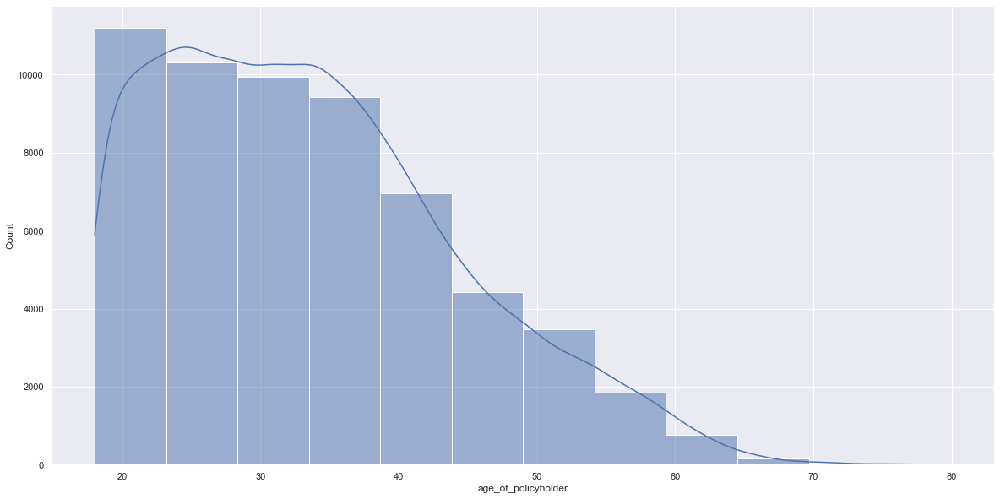

In [43]:
# Scatter Plot
sns.histplot(x='age_of_policyholder', 
             data=df_train_cleaned, bins=12, kde=True)

# Distribution of Policy Tenure

<AxesSubplot:xlabel='policy_tenure', ylabel='Count'>

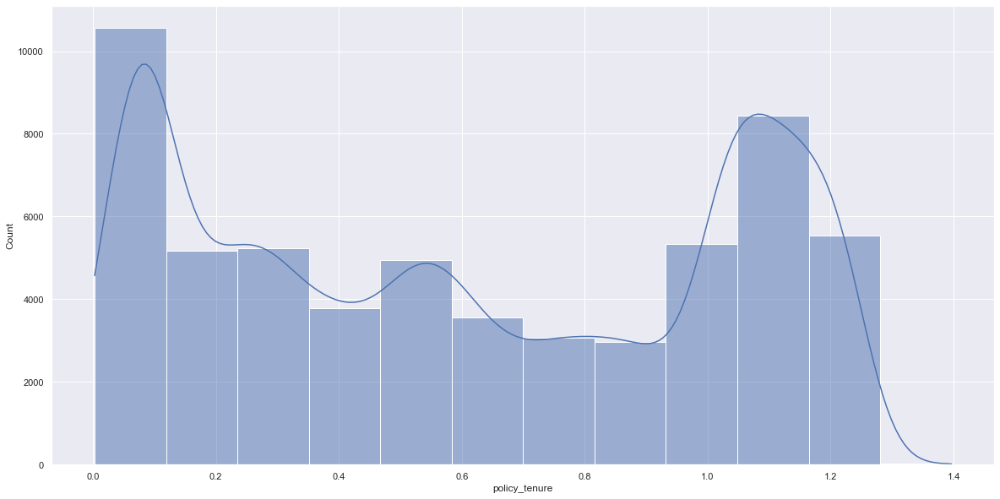

In [44]:
# Scatter Plot
sns.histplot(x='policy_tenure', 
             data=df_train_cleaned, bins=12, kde=True)

# KDE for policy tenure

<AxesSubplot:xlabel='policy_tenure', ylabel='Density'>

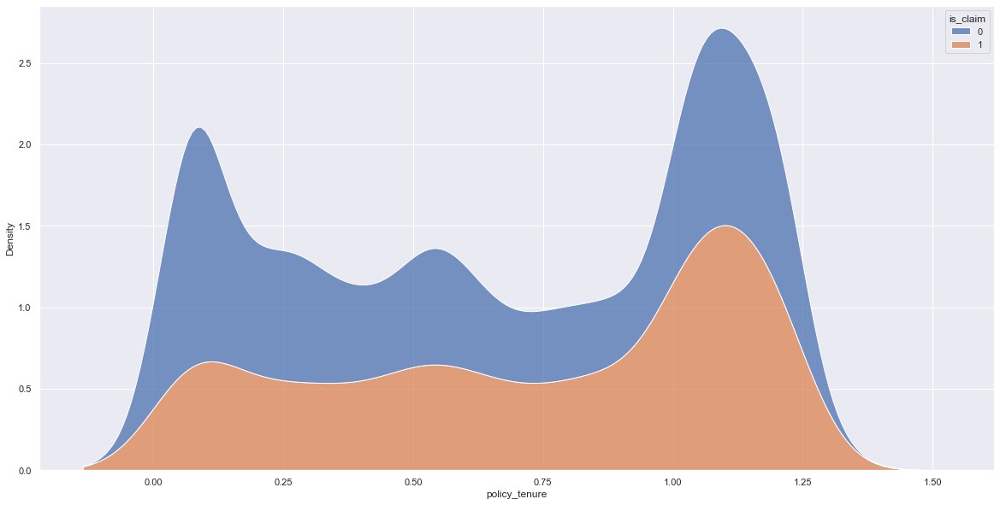

In [45]:
sns.kdeplot(data=df_train, x="policy_tenure", hue="is_claim", multiple="stack", common_norm=False)

# Model Vs Policy Count

In [46]:
df_temp1 = df_train_cleaned[['policy_id', 'model']].groupby('model').count()
df_temp1.reset_index(inplace=True)

<AxesSubplot:xlabel='model', ylabel='policy_id'>

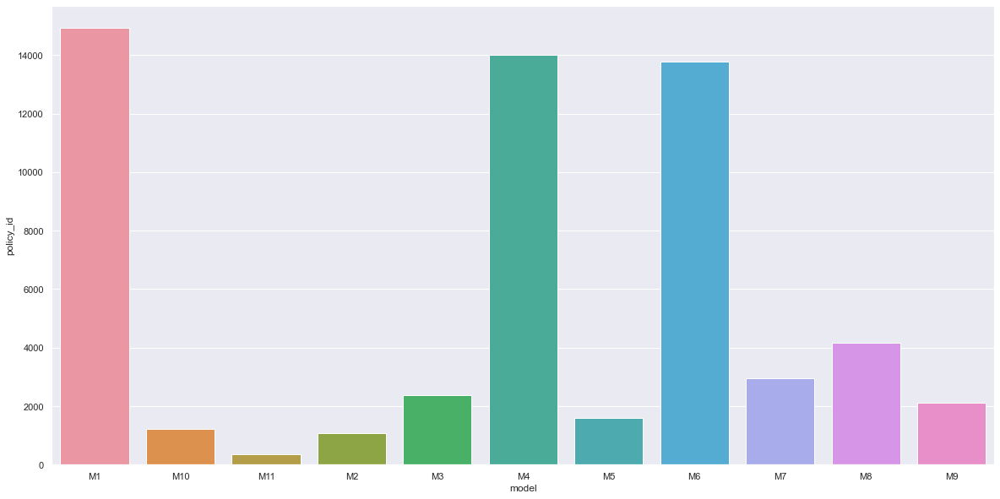

In [47]:
sns.barplot(x='model', y='policy_id', data=df_temp1)

# Model: Age of Car | Age of PolicyHolder | Population_density 

In [196]:
model_list = df_train_cleaned['model'].unique()
model_list
dict_model = {}
for model in model_list:
    temp ={
        'fuel_type': df_train_cleaned[df_train_cleaned['model'] == model].fuel_type.unique()[0],
        'population_density': df_train_cleaned[df_train_cleaned['model'] == model].population_density.sum(),
        'age_of_policyholder': df_train_cleaned[df_train_cleaned['model'] == model].age_of_policyholder.mean(),
        'age_of_car': df_train_cleaned[df_train_cleaned['model'] == model].age_of_car.mean(),
    }
    dict_model[model] = temp
    

df_model = pd.DataFrame(dict_model).transpose()
df_model = df_model.reset_index().rename(columns={'index':'model'}).astype({'population_density':int, 
                                                                            'age_of_policyholder':float,
                                                                           'age_of_car':float})
df_model


,model,fuel_type,population_density,age_of_policyholder,age_of_car
0,M1,CNG,322385353,34.641574,0.383801
1,M2,Petrol,19660124,32.495137,1.259251
2,M3,Petrol,45959405,32.394711,1.139949
3,M4,Diesel,232746310,33.713613,1.336860
4,M5,Diesel,30745310,33.741704,1.299499
5,M6,Petrol,235178604,34.651487,1.293188
6,M7,Petrol,51147692,33.056288,1.267908
7,M8,CNG,75635219,31.134157,1.104493
8,M9,Diesel,39767978,31.674781,1.083759
9,M10,CNG,22142676,31.977824,1.151861


In [201]:
fig = px.scatter(df_model, x="age_of_policyholder", y="age_of_car",color='fuel_type', size="population_density", hover_name="model", size_max=60)
fig.show()

# Is TPMS

In [175]:
df_tpms = df_train_cleaned.groupby('is_tpms').agg({'model':'unique', 'population_density':'sum', 'age_of_car':'mean'}).reset_index()
df_tpms

,is_tpms,model,population_density,age_of_car
0,0,"[M1, M2, M3, M5, M6, M7, M8, M9, M10, M11]",849675468,0.948422
1,1,[M4],232746310,1.336860


In [224]:
fig = px.scatter(df_tpms, x="is_tpms", 
                 y="age_of_car",
                 color='is_tpms',
                 size="population_density", 
                 hover_name="model", size_max=200)
fig.show()

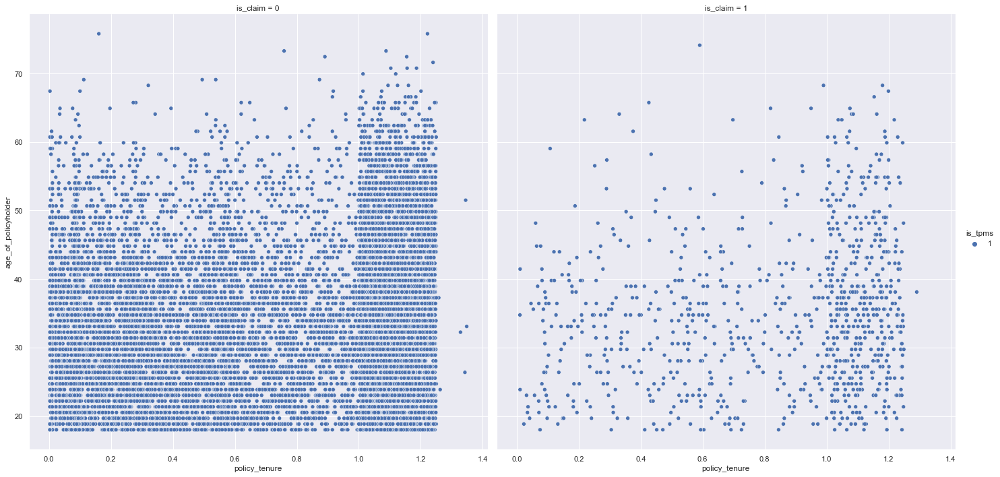

In [118]:
sns.relplot(x='policy_tenure', 
            y='age_of_policyholder',
            col='is_claim',
            data=df_train_cleaned[df_train_cleaned['model']=='M4'],hue='is_tpms', height=10)

# Is ECW

In [171]:
df_ecw = df_train_cleaned.groupby('is_ecw').agg({'model':'unique', 'population_density':'sum', 'age_of_car':'mean'}).reset_index()
df_ecw

,is_ecw,model,population_density,age_of_car
0,0,"[M1, M10]",344528029,0.441273
1,1,"[M2, M3, M4, M5, M6, M7, M8, M9, M11]",737893749,1.269811


In [206]:
fig = px.scatter(df_ecw, x="is_ecw", 
                 y="age_of_car", 
                 color='is_ecw',
                 size="population_density", 
                 hover_name="model", size_max=200)
fig.show()

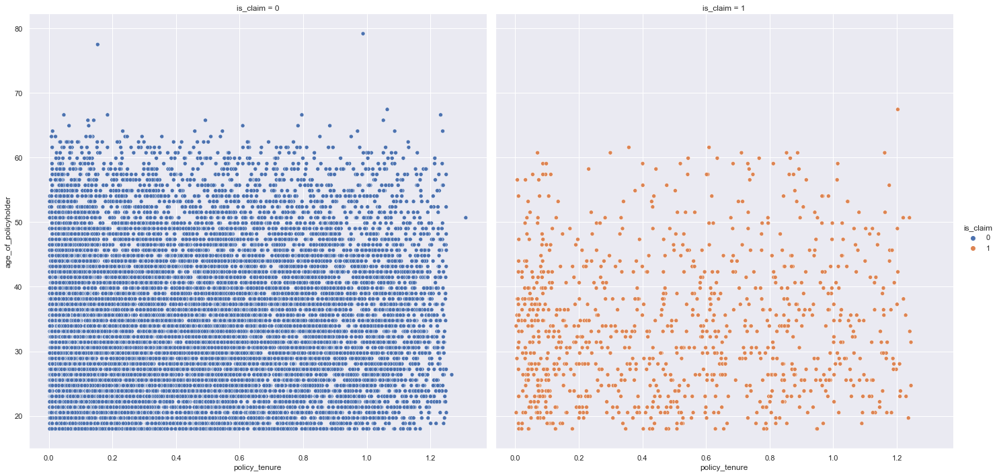

In [137]:
sns.relplot(x='policy_tenure', 
            y='age_of_policyholder',
            col='is_claim',
            data=df_train_cleaned[df_train_cleaned['is_ecw']==0],hue='is_claim', height=10)

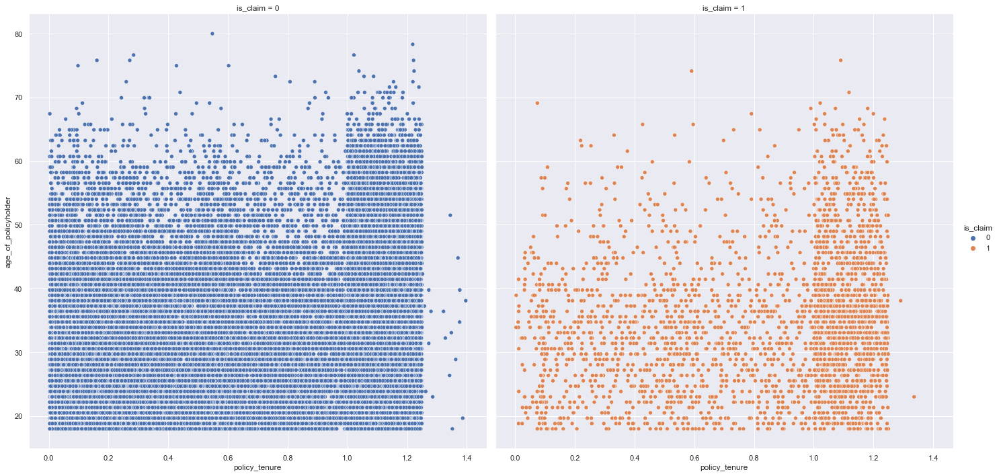

In [139]:
sns.relplot(x='policy_tenure', 
            y='age_of_policyholder',
            col='is_claim',
            data=df_train_cleaned[df_train_cleaned['is_ecw']==1],hue='is_claim', height=10)

# Manufacturer vs Claimed and Unclaimed Policy

In [54]:
df_make = df_train[['policy_id', 'make', 'is_claim']]
# df_make_pie = df_train[['policy_id', 'make', 'is_claim']].groupby('make').count().reset_index()

df_make_claimed = df_make[df_make['is_claim']==1]
df_make_unclaimed = df_make[df_make['is_claim']==0]

df_make_claimed_pie = df_make_claimed[['policy_id', 'make']].groupby('make').count().reset_index()
df_make_unclaimed_pie = df_make_unclaimed[['policy_id', 'make']].groupby('make').count().reset_index()

print(df_make_claimed[['policy_id', 'make']].groupby('make').count())
print(df_make_unclaimed[['policy_id', 'make']].groupby('make').count())

      policy_id
make           
1          2455
2           128
3           901
4           131
5           133
      policy_id
make           
1         35673
2          2245
3         13117
4          1830
5          1982


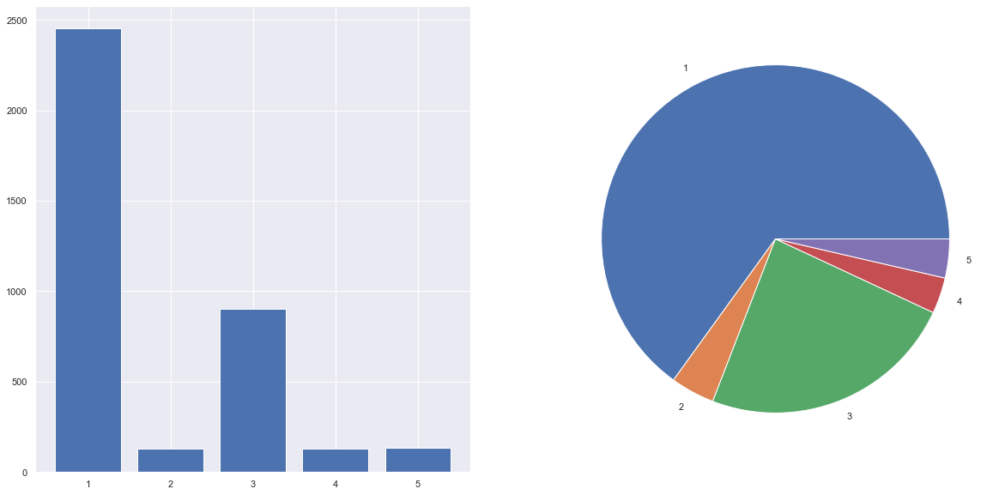

In [55]:
fig, ax = plt.subplots(1,2)
ax[0].bar(df_make_claimed_pie['make'], df_make_claimed_pie['policy_id'] )
ax[1].pie(df_make_unclaimed_pie['policy_id'], labels=df_make_unclaimed_pie['make'])
plt.show()

# Fuel Type Distribution

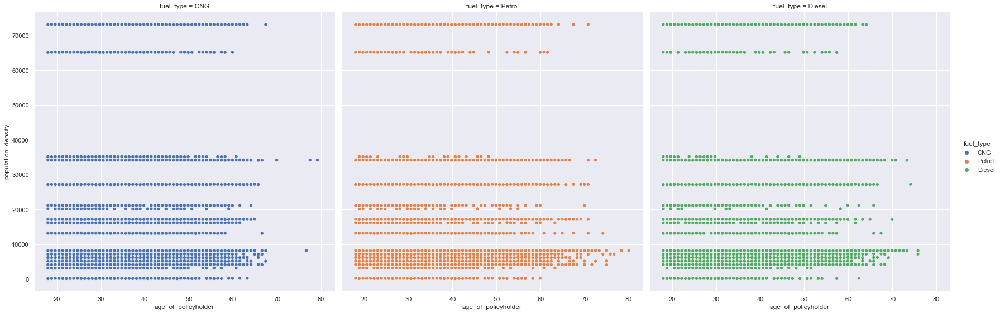

In [57]:
# Scatter Plot
sns.relplot(x='age_of_policyholder', 
            y='population_density',
            col='fuel_type',
            data=df_train_cleaned,hue='fuel_type', height=8)

# Stacked Bar Chart for Different Fuel Type

In [61]:
df_fuel_type = df_train_cleaned[['policy_id', 'population_density', 'fuel_type','is_claim']]
df_fuel_type[['population_density', 'fuel_type']].groupby('fuel_type').mean()

,population_density
fuel_type,
CNG,20667.154353
Diesel,17103.355592
Petrol,17483.146586


In [62]:
def count_fuel_type(df_fuel_type):
    fuel_type = df_fuel_type['fuel_type'].unique().tolist()
    claimed = []
    unclaimed = []
    
    for item in fuel_type:
        df_temp = df_fuel_type[df_fuel_type['fuel_type']==item]
        df_ = df_temp.groupby('is_claim').count().reset_index()
        unclaimed.append(df_[df_['is_claim']==0].policy_id.iloc[0])
        claimed.append(df_[df_['is_claim']==1].policy_id.iloc[0])
        
    return fuel_type, claimed, unclaimed

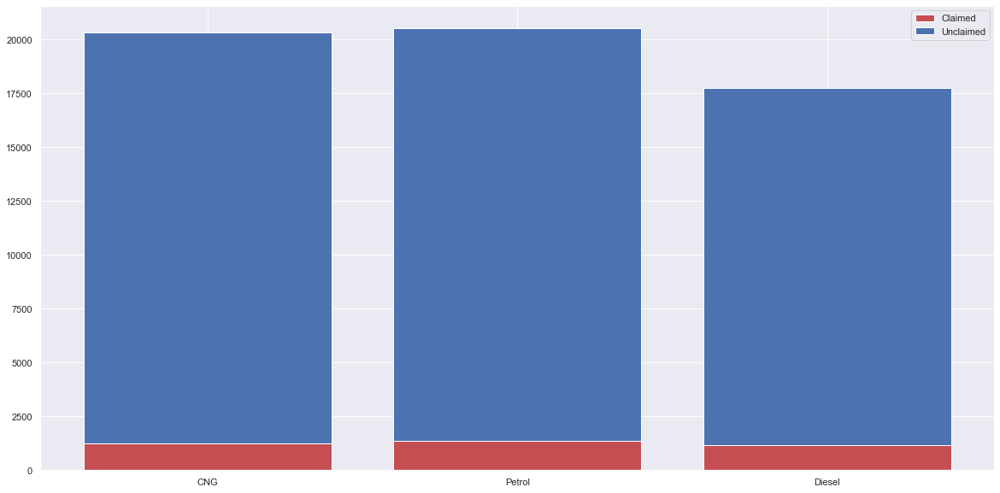

In [63]:
x, y1, y2 = count_fuel_type(df_fuel_type)
 
# plot bars in stack manner
plt.bar(x, y1, color='r')
plt.bar(x, y2, bottom=y1, color='b')
plt.legend(["Claimed", "Unclaimed"])
plt.show()

# Max Torque Vs Gross Weight

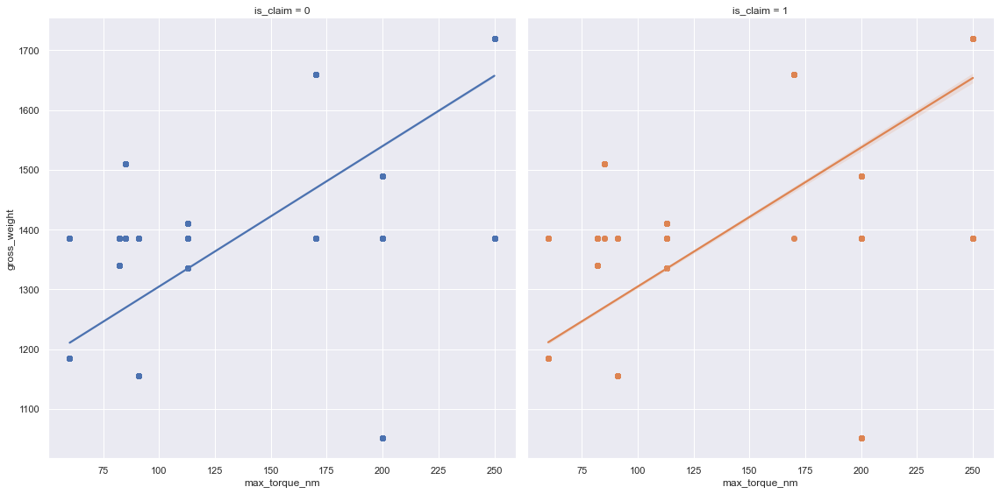

In [66]:
# Scatter Plot
sns.lmplot(x='max_torque_nm', 
            y='gross_weight',
           col='is_claim',
            data=df_train_cleaned, hue='is_claim', height=8)

# Joint Plot for age of policyholder and area_cluster

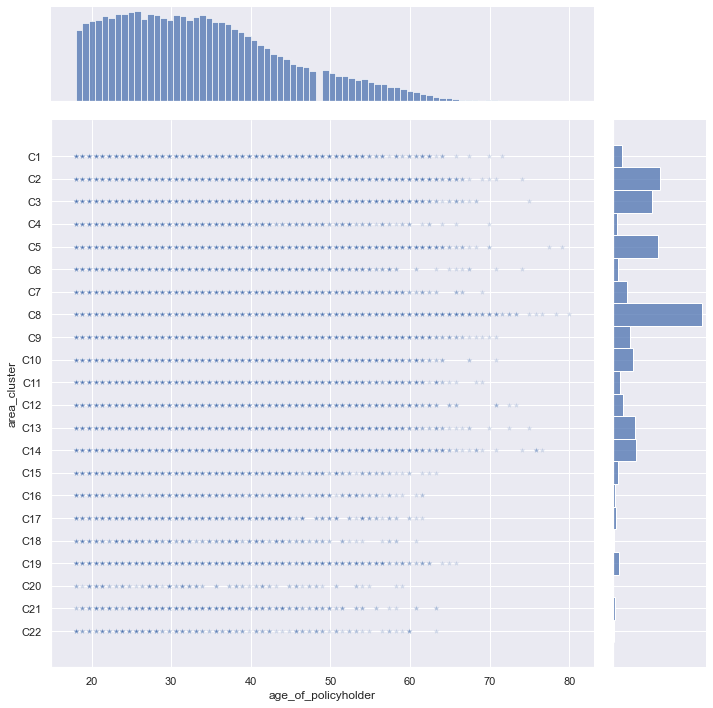

In [67]:
sns.jointplot(x='age_of_policyholder', y='area_cluster', data=df_train_cleaned, alpha=.25, marker='*', height=10)

<AxesSubplot:xlabel='area_cluster', ylabel='count'>

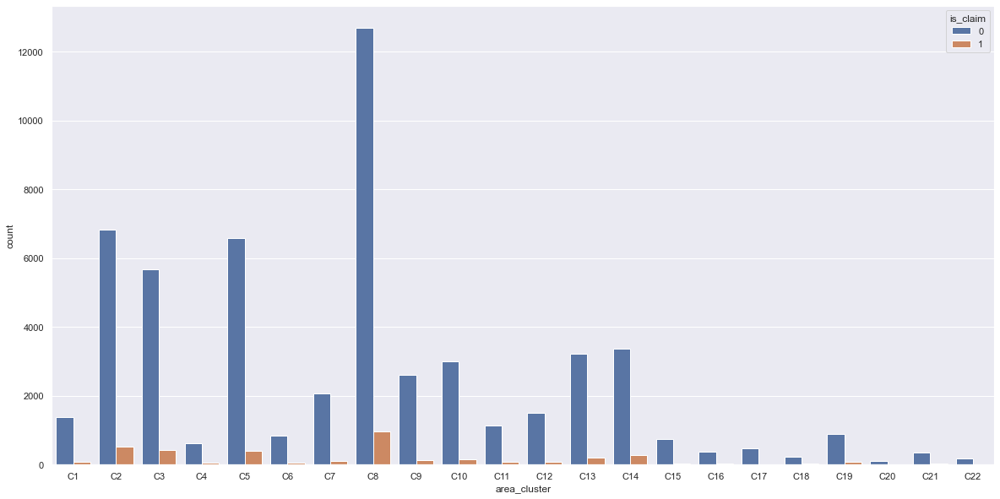

In [68]:
sns.countplot(x='area_cluster',hue='is_claim',data=df_train_cleaned)

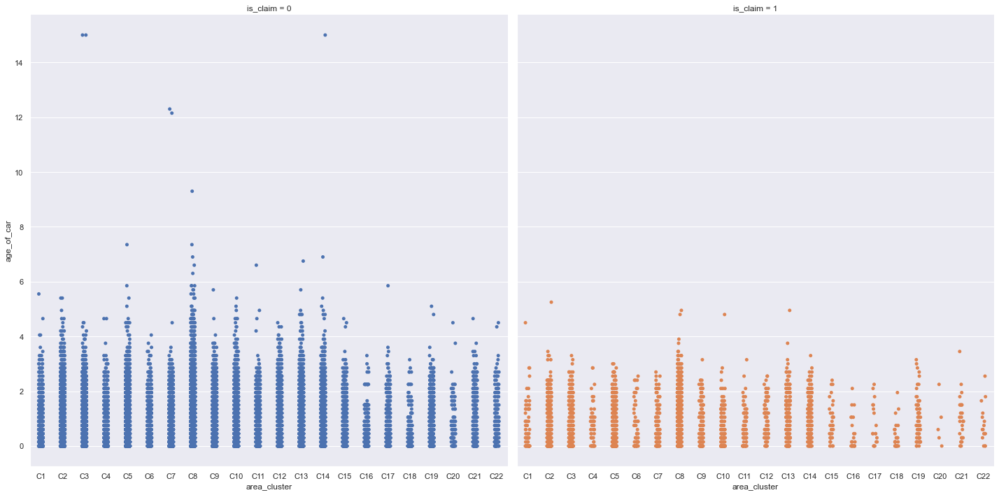

In [69]:
sns.catplot(x='area_cluster',y='age_of_car',data=df_train_cleaned, height=10, hue='is_claim', col='is_claim')

<AxesSubplot:xlabel='area_cluster', ylabel='policy_tenure'>

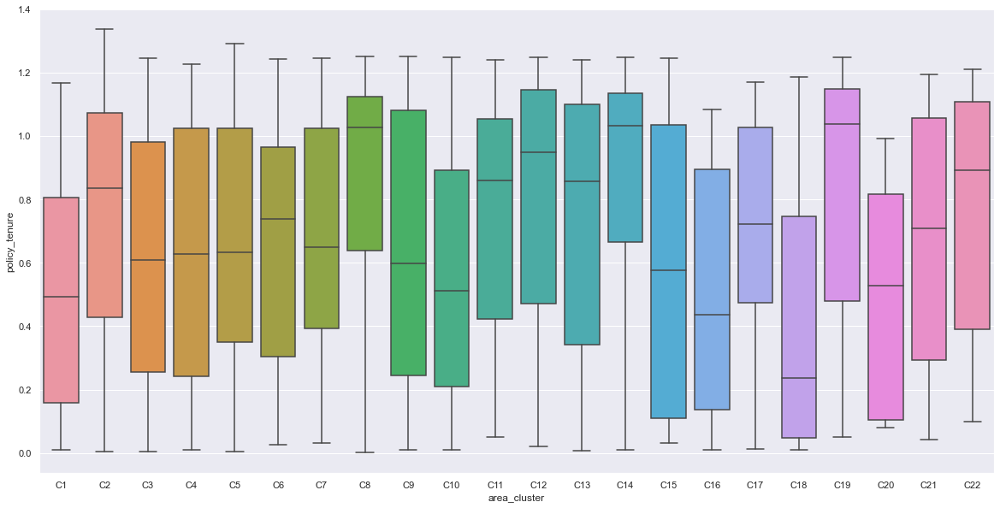

In [70]:
y_claimed = df_train_cleaned[df_train_cleaned['is_claim']==1].policy_tenure
sns.boxplot(x= df_train_cleaned.area_cluster,y=y_claimed)

In [71]:
df_temp = df_train_cleaned[['area_cluster', 'model', 'policy_id']]

In [72]:
df_temp.groupby('area_cluster').count().reset_index()

,area_cluster,model,policy_id
0,C1,1468,1468
1,C10,3155,3155
2,C11,1212,1212
3,C12,1589,1589
4,C13,3423,3423
5,C14,3660,3660
6,C15,771,771
7,C16,401,401
8,C17,492,492
9,C18,242,242


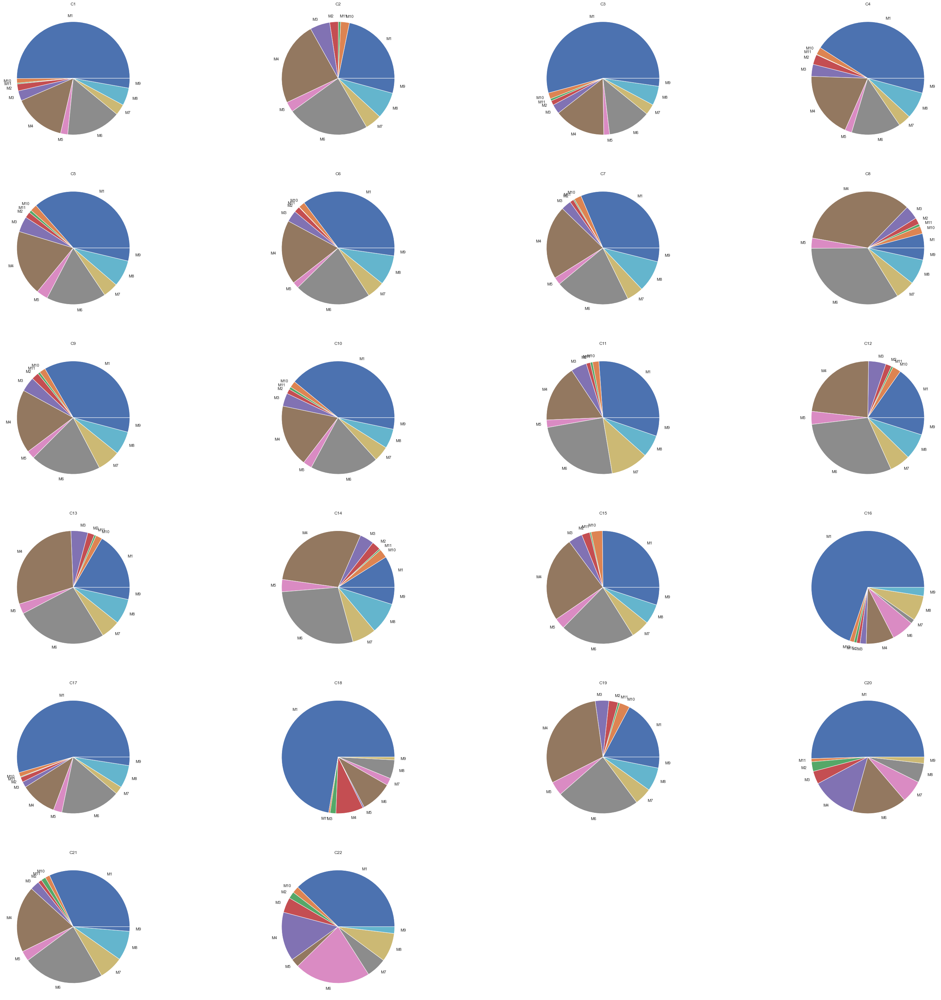

In [73]:
fig, ax = plt.subplots(nrows=6, ncols=4, figsize=(50, 50))
i=0
j=0
for item in df_temp.area_cluster.unique():
    df__ = df_temp[df_temp.area_cluster==item].groupby('model').count().reset_index()
    ax[i, j].pie(df__['policy_id'], labels=df__['model'])
    ax[i,j].set_title(item)
    j += 1
    if item != 'C22':
        if j==4:
            j=0
            i+=1
            
ax[5, 2].set_visible(False)
ax[5, 3].set_visible(False)

In [75]:
df_train_cleaned['age_of_car'].unique()

array([ 0.75,  0.3 ,  1.65,  1.05,  2.4 ,  2.1 ,  0.6 ,  0.15,  1.8 ,
        0.45,  1.5 ,  1.35,  0.  ,  1.2 ,  2.25,  1.95,  5.85,  2.55,
        0.9 ,  2.7 ,  3.  ,  4.35,  2.85,  5.7 ,  3.3 ,  3.45,  3.9 ,
        3.15,  4.05,  4.2 ,  4.5 ,  3.75,  4.65,  4.95,  5.25,  4.8 ,
        3.6 ,  5.55, 15.  ,  6.3 ,  5.4 ,  6.75,  7.35,  6.9 ,  5.1 ,
       12.3 ,  6.6 ,  9.3 , 12.15])

In [208]:


fig = px.scatter(df_train_cleaned.query("is_claim==1"),
                 x="policy_tenure", 
                 y="age_of_car", 
#                  size="pop", 
                 color="is_claim",
#                  hover_name="population_density", 
                 log_x=True, size_max=20)
fig.show()

In [77]:
fig = px.scatter(df_train_cleaned.query("is_claim==1"),
                 x="policy_tenure", 
                 y="age_of_car", 
#                  size="pop", 
                 color="is_claim",
#                  hover_name="population_density", 
                 log_x=True, size_max=20)
fig.show()

In [210]:
fig = px.scatter_matrix(df_train_cleaned, dimensions=["age_of_car", "policy_tenure", "age_of_policyholder", "population_density"], color="is_claim")
fig.show()

# Parallel Coordinates

In [79]:
df_parall = df_train_cleaned[[
        'ncap_rating',
#                               'max_power_rpm', 
                              'max_torque_nm', 
#                               'max_torque_rpm',
#                               'displacement',
#                               'gross_weight',
                                'max_power_bhp', 
                                'age_of_car',
                              'is_claim',

]]
df_parall

,ncap_rating,max_torque_nm,max_power_bhp,age_of_car,is_claim
0,0,60.0,40.36,0.75,0
1,0,60.0,40.36,0.30,0
2,0,60.0,40.36,0.30,0
3,2,113.0,88.50,1.65,0
4,2,91.0,67.06,1.65,0
...,...,...,...,...,...
58590,2,91.0,67.06,1.95,0
58591,0,60.0,40.36,0.30,0
58592,0,60.0,40.36,0.75,0
58593,2,113.0,88.50,2.10,0


In [178]:
fig = px.parallel_coordinates(df_parall, color="is_claim", 
                    color_continuous_scale=px.colors.diverging.Tealrose, color_continuous_midpoint=2)
fig.show()


### Normalization is required for columns related to age of policyholders as well as age of car

In [81]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

def scale_column_to_range(df, column_name, target_range):
    """
    Scales the values in a specific column of a Pandas DataFrame to a target range,
    using the MinMaxScaler.

    Parameters:
    df (pandas.DataFrame): The input DataFrame containing the column to be scaled.
    column_name (str): The name of the column to be scaled.
    target_range (tuple): The target range for the scaled values, as a tuple of two floats (min, max).

    Returns:
    pandas.DataFrame: A new DataFrame with the scaled column values.
    """

    # copy the input DataFrame to avoid modifying the original
    df_scaled = df.copy()

    # extract the column to be scaled
    column = df_scaled[column_name]

    # create a MinMaxScaler object with the target range
    scaler = MinMaxScaler(feature_range=target_range)

    # fit and transform the column with the scaler
    column_scaled = scaler.fit_transform(column.to_numpy().reshape(-1, 1))

    # replace the original column with the scaled values
    df_scaled[column_name] = column_scaled

    return df_scaled


In [82]:
df_train_cleaned_normalized = scale_column_to_range(df_train_cleaned, 'age_of_car',(0,1))
df_train_cleaned_normalized = scale_column_to_range(df_train_cleaned, 'age_of_policyholder',(0,1))

# print the normalized dataFrames
df_train_cleaned_normalized

,policy_id,policy_tenure,age_of_car,age_of_policyholder,area_cluster,population_density,make,segment,model,fuel_type,...,is_driver_seat_height_adjustable,is_day_night_rear_view_mirror,is_ecw,is_speed_alert,ncap_rating,is_claim,max_torque_nm,max_torque_rpm,max_power_bhp,max_power_rpm
0,ID00001,0.515874,0.75,0.500000,C1,4158,1,A,M1,CNG,...,0,0,0,1,0,0,60.0,3500,40.36,6000
1,ID00002,0.672619,0.30,0.121622,C2,27129,1,A,M1,CNG,...,0,0,0,1,0,0,60.0,3500,40.36,6000
2,ID00003,0.841110,0.30,0.135135,C3,4188,1,A,M1,CNG,...,0,0,0,1,0,0,60.0,3500,40.36,6000
3,ID00004,0.900277,1.65,0.202703,C4,21179,1,C1,M2,Petrol,...,1,1,1,1,2,0,113.0,4400,88.50,6000
4,ID00005,0.596403,1.65,0.486486,C5,34170,2,A,M3,Petrol,...,0,1,1,1,2,0,91.0,4250,67.06,5500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58590,ID58588,0.355089,1.95,0.500000,C8,8118,2,A,M3,Petrol,...,0,1,1,1,2,0,91.0,4250,67.06,5500
58591,ID58589,1.199642,0.30,0.324324,C14,7141,1,A,M1,CNG,...,0,0,0,1,0,0,60.0,3500,40.36,6000
58592,ID58590,1.162273,0.75,0.229730,C5,34169,1,A,M1,CNG,...,0,0,0,1,0,0,60.0,3500,40.36,6000
58593,ID58591,1.236307,2.10,0.378378,C8,8166,1,B2,M6,Petrol,...,1,1,1,1,2,0,113.0,4400,88.50,6000


# Detect and treat outliers

In [83]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_numerical_columns(df):
    """
    Creates a 6x6 matrix of boxplots for all numerical columns in the input DataFrame using seaborn.
    
    Args:
        df (pandas.DataFrame): The input DataFrame.
        
    Returns:
        None
    """
    # select only the numerical columns
    num_cols = df.select_dtypes(include='number').columns
    
    # create a 6x6 matrix of figures for all numerical columns
    num_cols_count = len(num_cols)
    fig, axes = plt.subplots(nrows=6, ncols=6, figsize=(30, 30))
    for i in range(6):
        for j in range(6):
            if i*6+j < num_cols_count:
                sns.boxplot(x=df[num_cols[i*6+j]], ax=axes[i][j], linewidth=2, width=0.5)
                axes[i][j].set_title(num_cols[i*6+j], fontsize=20)
                axes[i][j].set_xlabel('', fontsize=16)
                axes[i][j].set_ylabel('', fontsize=16)
            else:
                axes[i][j].set_visible(False)


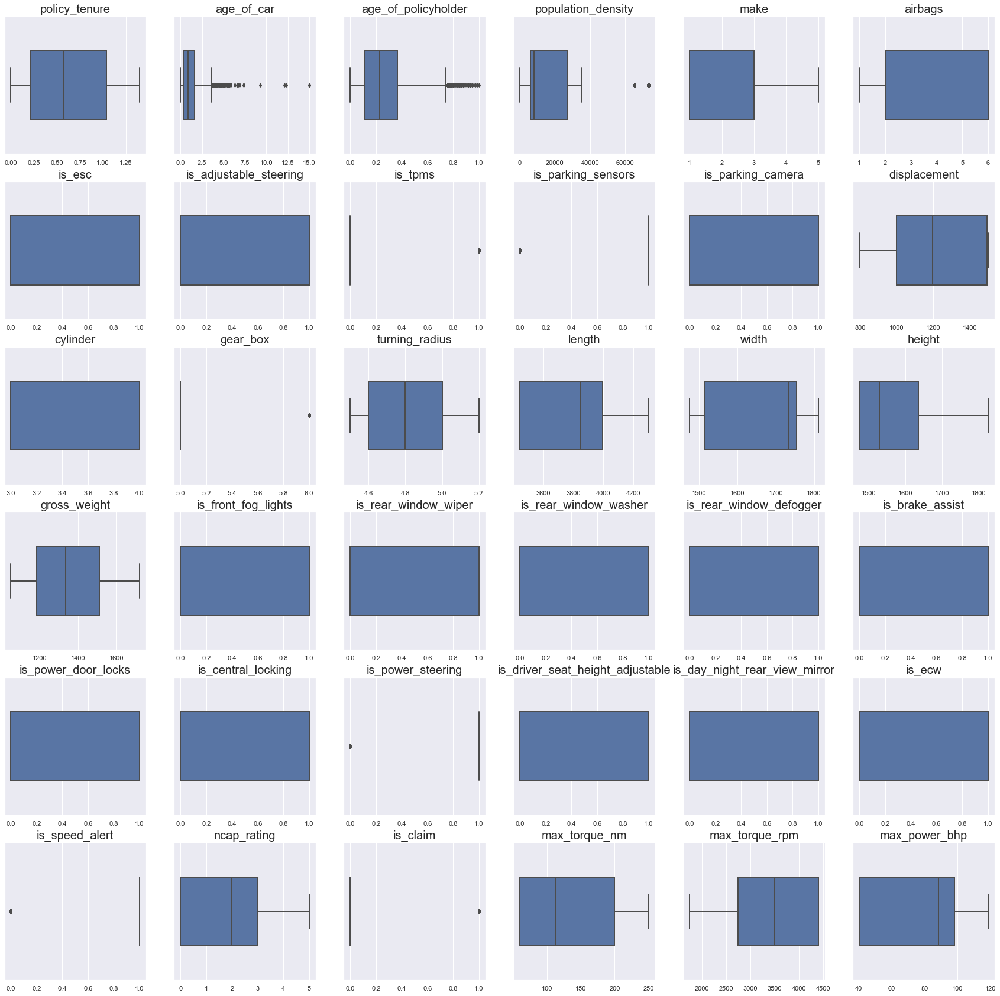

In [84]:
plot_numerical_columns(df_train_cleaned_normalized)

In [85]:
import pandas as pd

def iqr_outlier_treatment(df, k=1.5):
    """
    Performs outlier treatment using IQR (Interquartile Range) on all numerical columns in a pandas DataFrame.
    
    Args:
        df (pandas.DataFrame): The input DataFrame.
        k (float, optional): The multiplier for the IQR, defaults to 1.5.
        
    Returns:
        pandas.DataFrame: The cleaned DataFrame with outliers treated.
    """
    # select only the numerical columns
    num_cols = df.select_dtypes(include='number').columns
#     print(num_cols.values)
    num_cols = list(num_cols.values)
    num_cols.remove('is_claim')
    
    # create a copy of the input DataFrame
    df_clean = df.copy()
    
    # iterate over each numerical column and apply the IQR outlier treatment
    for col in num_cols:
        q1, q3 = df_clean[col].quantile([0.25, 0.75])
        iqr = q3 - q1
        lower_bound = q1 - k*iqr
        upper_bound = q3 + k*iqr
        df_clean[col] = df_clean[col].clip(lower_bound, upper_bound)
    
    return df_clean


In [86]:
df_preprocessed = iqr_outlier_treatment(df_train_cleaned_normalized)

In [87]:
df_preprocessed.head(5)

,policy_id,policy_tenure,age_of_car,age_of_policyholder,area_cluster,population_density,make,segment,model,fuel_type,...,is_driver_seat_height_adjustable,is_day_night_rear_view_mirror,is_ecw,is_speed_alert,ncap_rating,is_claim,max_torque_nm,max_torque_rpm,max_power_bhp,max_power_rpm
0,ID00001,0.515874,0.75,0.500000,C1,4158.0,1,A,M1,CNG,...,0,0,0,1.0,0,0,60.0,3500,40.36,6000
1,ID00002,0.672619,0.30,0.121622,C2,27129.0,1,A,M1,CNG,...,0,0,0,1.0,0,0,60.0,3500,40.36,6000
2,ID00003,0.841110,0.30,0.135135,C3,4188.0,1,A,M1,CNG,...,0,0,0,1.0,0,0,60.0,3500,40.36,6000
3,ID00004,0.900277,1.65,0.202703,C4,21179.0,1,C1,M2,Petrol,...,1,1,1,1.0,2,0,113.0,4400,88.50,6000
4,ID00005,0.596403,1.65,0.486486,C5,34170.0,2,A,M3,Petrol,...,0,1,1,1.0,2,0,91.0,4250,67.06,5500


In [88]:
# Droping ID
df_preprocessed.drop(columns=['policy_id', 'max_torque', 'max_power', 'area_cluster'], axis=1, inplace=True)

In [89]:
df_preprocessed.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 58595 entries, 0 to 58594
Data columns (total 44 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   policy_tenure                     58595 non-null  float64
 1   age_of_car                        58595 non-null  float64
 2   age_of_policyholder               58595 non-null  float64
 3   population_density                58595 non-null  float64
 4   make                              58595 non-null  int64  
 5   segment                           58595 non-null  object 
 6   model                             58595 non-null  object 
 7   fuel_type                         58595 non-null  object 
 8   engine_type                       58595 non-null  object 
 9   airbags                           58595 non-null  int64  
 10  is_esc                            58595 non-null  int64  
 11  is_adjustable_steering            58595 non-null  int64  
 12  is_t

In [90]:
obj_list = df_preprocessed.select_dtypes(include='object').columns

### Modeling 

In [91]:
for obj in obj_list:
    df_dummy = pd.get_dummies(df_preprocessed[obj], prefix=obj)
    df_preprocessed = pd.concat([df_preprocessed, df_dummy], axis=1)

df_preprocessed.drop(columns=obj_list, axis=1, inplace=True)

In [92]:
from sklearn.model_selection import train_test_split

In [93]:
df_features = df_preprocessed.drop(columns='is_claim',axis=1)

In [94]:
X_train, X_test, y_train, y_test = train_test_split(
    df_features, df_preprocessed['is_claim'], test_size=0.25, random_state=10)

In [95]:
print(len(X_train.columns))
print(len(X_train.columns.unique()))

74
74


In [229]:
def get_metrics(model, y_true, y_pred):
    dict_metrics = {}
    dict_metrics['accuracy'] = accuracy_score(y_true, y_pred)
    dict_metrics['f1_score'] = f1_score(y_true, y_pred)
    dict_metrics['recall_score'] = recall_score(y_true, y_pred)
    dict_metrics['precision_score'] = precision_score(y_true, y_pred)
    dict_metrics['mean_absolute_error'] = mean_absolute_error(y_true, y_pred)
    dict_metrics['mean_squared_error'] = mean_squared_error(y_true, y_pred)
    
    return dict_metrics

In [234]:
model_metrics = {}

import xgboost as xgb
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, mean_absolute_error, mean_squared_error, confusion_matrix
xgb_cl = xgb.XGBClassifier()
xgb_cl.fit(X_train, y_train)
preds = xgb_cl.predict(X_test)
# model_metrics['xgb_boost'] = get_metrics(xgb_cl, y_test, preds)
# confusion_matrix(y_test, preds)

In [235]:
preds = xgb_cl.predict(X_train)
accuracy_score(y_train, preds)
model_metrics['xgb_boost'] = get_metrics(xgb_cl, y_train, preds)
confusion_matrix(y_train, preds)

array([[41120,     1],
       [ 2717,   108]])

In [236]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators = 100) 
rfc.fit(X_train, y_train)
preds = rfc.predict(X_test)

# model_metrics['rfc'] = get_metrics(rfc, y_test, preds)
# model_metrics

In [237]:
preds = rfc.predict(X_train)
accuracy_score(y_train, preds)
model_metrics['rfc'] = get_metrics(rfc, y_train, preds)
model_metrics

{'xgb_boost': {'accuracy': 0.9381513675874937,
  'f1_score': 0.07361963190184048,
  'recall_score': 0.03823008849557522,
  'precision_score': 0.9908256880733946,
  'mean_absolute_error': 0.06184863241250626,
  'mean_squared_error': 0.06184863241250626},
 'rfc': {'accuracy': 0.9998634688026214,
  'f1_score': 0.9989369241672573,
  'recall_score': 0.9978761061946902,
  'precision_score': 1.0,
  'mean_absolute_error': 0.00013653119737860102,
  'mean_squared_error': 0.00013653119737860102}}

In [240]:
from sklearn.naive_bayes import GaussianNB
nb = GaussianNB()
nb.fit(X_train, y_train)
preds = nb.predict(X_test)
# model_metrics['nb'] = get_metrics(nb, y_test, preds)
# model_metrics

In [241]:
preds = nb.predict(X_train)
accuracy_score(y_train, preds)
model_metrics['nb'] = get_metrics(rfc, y_train, preds)
model_metrics

/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.



{'xgb_boost': {'accuracy': 0.9381513675874937,
  'f1_score': 0.07361963190184048,
  'recall_score': 0.03823008849557522,
  'precision_score': 0.9908256880733946,
  'mean_absolute_error': 0.06184863241250626,
  'mean_squared_error': 0.06184863241250626},
 'rfc': {'accuracy': 0.9998634688026214,
  'f1_score': 0.9989369241672573,
  'recall_score': 0.9978761061946902,
  'precision_score': 1.0,
  'mean_absolute_error': 0.00013653119737860102,
  'mean_squared_error': 0.00013653119737860102},
 'nb': {'accuracy': 0.9357165612342421,
  'f1_score': 0.0,
  'recall_score': 0.0,
  'precision_score': 0.0,
  'mean_absolute_error': 0.06428343876575797,
  'mean_squared_error': 0.06428343876575797}}